### Introduction

In this project, we analyze the diabetes diagnosis dataset using machine learning techniques such as Decision Tree, K-Nearest Neighbors (KNN), and Support Vector Machine (SVM). This notebook demonstrates how to apply machine learning to a real-world dataset, evaluate the results, and visualize the outcomes effectively.

### Data Content:

This code uses the Pima Indian Diabetes Dataset from the National Institute of Diabetes and Digestive and Kidney Diseases. The objective is to predict whether a patient has diabetes based on diagnostic measurements.
The dataset is available in the public domain under the Creative Commons Zero (CC0) license.

**Source:** National Institute of Diabetes and Digestive and Kidney Diseases

**Original Donor:** Vincent Sigillito (vgs@aplcen.apl.jhu.edu), Research Center, RMI Group Leader, Applied Physics Laboratory, The Johns Hopkins University.

**Date Received:** 9 May 1990

### Data Parameters:
All patients here are females at least 21 years old of Pima Indian heritage.

- **Pregnancies:** Number of times pregnant
- **Glucose:** Plasma glucose concentration a 2 hours in an oral glucose tolerance test
- **BloodPressure:** Diastolic blood pressure (mm Hg)
- **SkinThickness:** Triceps skin fold thickness (mm)
- **Insulin:** 2-Hour serum insulin (mu U/ml)
- **BMI:** Body mass index (weight in kg/(height in m)^2)
- **DiabetesPedigreeFunction:** Diabetes pedigree function
- **Age:** Age (years)
- **Outcome:** Class variable (0 or 1)

### Import Libraries and Load Dataset

Import the necessary libraries and read the dataset.

In [1]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import seaborn as sns

from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
from sklearn.model_selection import KFold
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import classification_report
from sklearn import tree
from sklearn.neighbors import KNeighborsClassifier
from sklearn import svm

### Data Preparation

Before analysis, careful data cleaning is essential. We inspect the dataset using `info()` to confirm there are no null values. 

In [2]:
# Read the dataset
df = pd.read_csv("diabetes.csv")

# Print DataFrame info and first few rows
print("\nDataFrame Info:")
df.info()

print("\nDataFrame Values:")
print(df.head())


DataFrame Info:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 768 entries, 0 to 767
Data columns (total 9 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   Pregnancies               768 non-null    int64  
 1   Glucose                   768 non-null    int64  
 2   BloodPressure             768 non-null    int64  
 3   SkinThickness             768 non-null    int64  
 4   Insulin                   768 non-null    int64  
 5   BMI                       768 non-null    float64
 6   DiabetesPedigreeFunction  768 non-null    float64
 7   Age                       768 non-null    int64  
 8   Outcome                   768 non-null    int64  
dtypes: float64(2), int64(7)
memory usage: 54.1 KB

DataFrame Values:
   Pregnancies  Glucose  BloodPressure  SkinThickness  Insulin   BMI  \
0            6      148             72             35        0  33.6   
1            1       85             66             29       

Check for duplicates and zero values. Although no duplicate entries were found, 376 out of 768 records contained zero values (nearly half of the dataset). These zeros were replaced with the median values to ensure reasonable results.

In [3]:
# Count of duplicated rows
duplicated_rows = df.duplicated().sum()

# Count of zero values per column
zero_values_per_column = (df == 0).sum()

# Printing the results
print(f'Duplicated rows are: \n{duplicated_rows}\n')
print(f'Zero values per column are: \n{zero_values_per_column}\n')

Duplicated rows are: 
0

Zero values per column are: 
Pregnancies                 111
Glucose                       5
BloodPressure                35
SkinThickness               227
Insulin                     374
BMI                          11
DiabetesPedigreeFunction      0
Age                           0
Outcome                     500
dtype: int64



In [4]:
# Identify outliers based on conditions where certain columns have a value of 0
outliers = (
    (df["Glucose"] == 0) | 
    (df["BloodPressure"] == 0) | 
    (df["SkinThickness"] == 0) | 
    (df["Insulin"] == 0) | 
    (df["BMI"] == 0)
)

outliers.sum()


376

In [5]:
lst=['Glucose','BloodPressure','SkinThickness','Insulin','BMI']
for i in lst:
    df[i] = df[i].replace(0, np.nan)  # Replace 0s with NaN
    df[i] = df[i].fillna(df[i].median())  # Replace NaNs with the median of the column

### Data Visualization

The cleaned dataset is visualized using a Seaborn pairplot to explore relationships between variables.

<Figure size 1200x800 with 0 Axes>

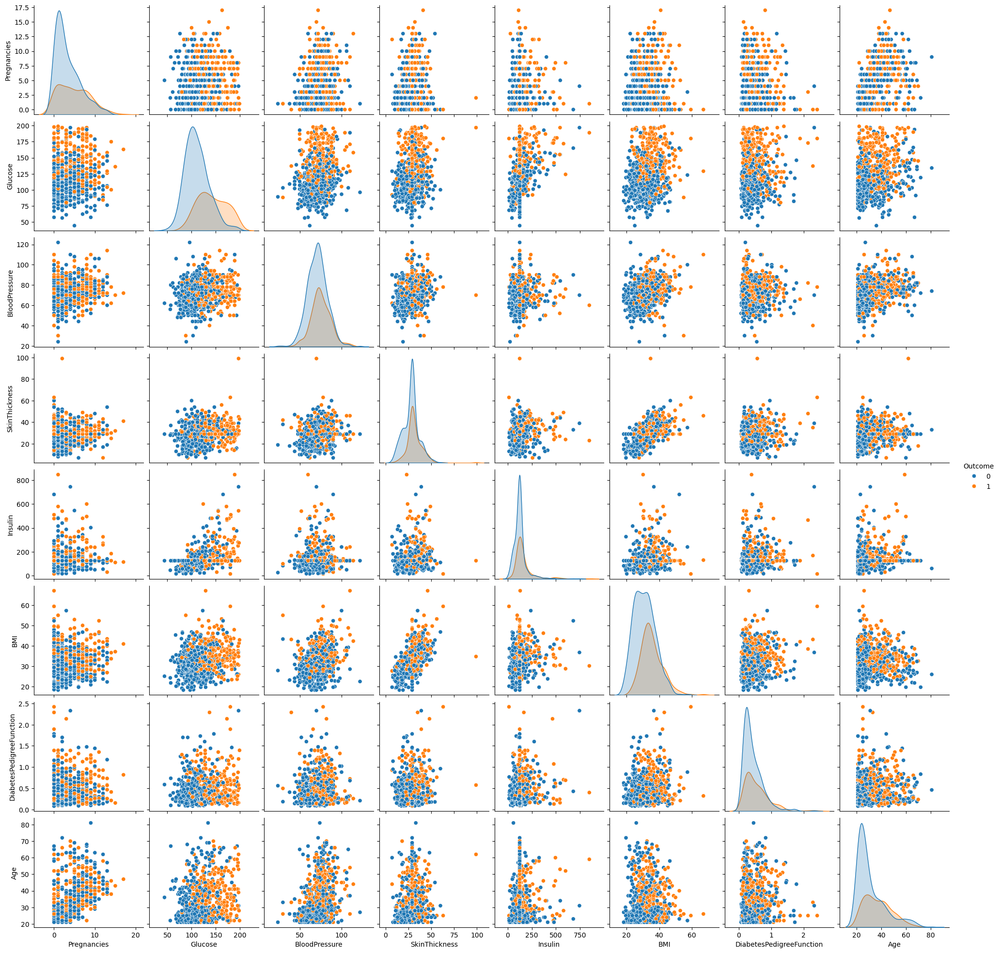

In [6]:
# Plot pair plot for all data.
plt.figure(figsize=(12, 8))
sns.pairplot(df, hue='Outcome')
plt.show()

### Preparation for Training Dataset

In [7]:
X = df.drop(['Outcome'],axis =1)
y_true = df.Outcome

The dataset is split into training (80%) and test (20%) sets.

In [8]:
# Split data set into train and test data.
train_X, test_X, train_y, test_y = train_test_split(X, y_true, test_size=0.2, random_state=42)

### Decision Tree
To determine the optimal hyperparameters for each model, we use GridSearchCV, which includes k-fold cross-validation to prevent overfitting. A consistent random state (42) is used to ensure reproducibility of results.
The relationship between hyperparameters and accuracy is depicted in the following graphs.

-----------------Decision Tree-----------------

Best Parameters: {'max_depth': 5}
Best Cross-Validation Score (Accuracy): 0.7425965097831834


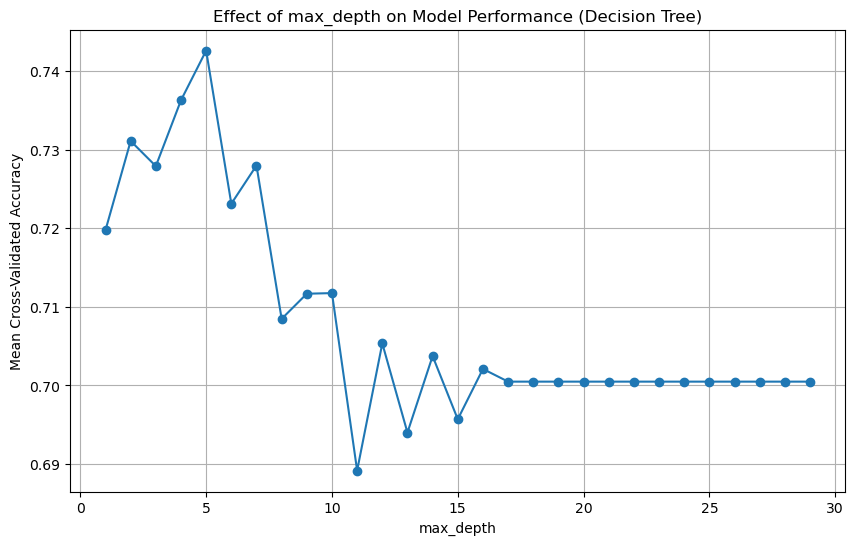

In [9]:
# Define the parameter grid for max_depth
param_grid = {'max_depth': np.arange(1, 30)}

# Initialize the Decision Tree Classifier
# Fix random state to reproduce the same result for decision tree node splits
# When multiple features provide the same splitting criterion value (e.g., Gini impurity or entropy), 
# the algorithm might randomly select one of the features to split the node
clf = tree.DecisionTreeClassifier(random_state=42)

# Initialize KFold with random_state and shuffle=True
# Fix random state to reproduce the same result for K-Fold cross-validation splits
kf = KFold(n_splits=10, shuffle=True, random_state=42)

# Initialize GridSearchCV with cross-validation
grid_search = GridSearchCV(estimator=clf, param_grid=param_grid, cv=kf, scoring='accuracy')

# Fit GridSearchCV to the training data
grid_search.fit(train_X, train_y)
   

# Define the function to plot palameter effect
def plot_parameter_effect(grid_search, param, model, xlabel, ylabel):
    print(f'\nBest Parameters: {grid_search.best_params_}')
    print(f'Best Cross-Validation Score (Accuracy): {grid_search.best_score_}')

    # Extract mean test scores for each value of the parameter
    mean_test_scores = grid_search.cv_results_['mean_test_score']
    param_values = grid_search.cv_results_[f'param_{param}'].data

    plt.figure(figsize=(10, 6))
    plt.plot(param_values, mean_test_scores, marker='o')
    plt.xlabel(xlabel)
    plt.ylabel(ylabel)
    plt.title("Effect of " + param + " on Model Performance (" + model + ")")
    plt.grid(True)
    plt.show()
    
# Plot max_depth vs. accuracy
plot_parameter_effect(grid_search, "max_depth", "Decision Tree",
                      "max_depth", "Mean Cross-Validated Accuracy")

To evaluate the models' performance, we use the classification report and confusion matrix. The report provides metrics like precision, recall, and F1-score, with a focus on average accuracy. The confusion matrix offers a clear understanding of model accuracy.

Training data
              precision    recall  f1-score   support

           0      0.924     0.818     0.868       401
           1      0.718     0.873     0.788       213

    accuracy                          0.837       614
   macro avg      0.821     0.846     0.828       614
weighted avg      0.853     0.837     0.840       614



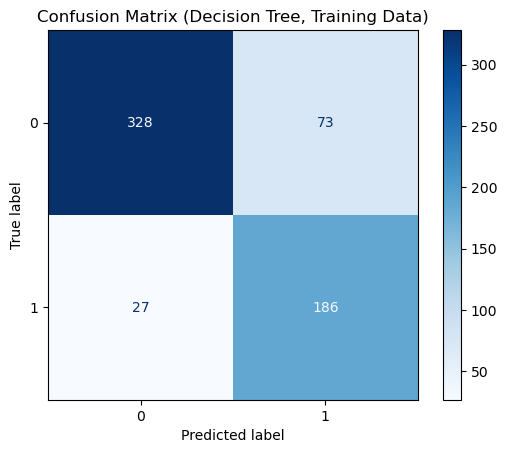

In [10]:
# Define the function to evaluate the model and plot confusion matrix
def evaluate_model(grid_search, X, y, data_type, Algorithm):
    print(f"{data_type} data\n{classification_report(y, grid_search.predict(X), digits=3)}")
    conf_mat = confusion_matrix(y, grid_search.predict(X))
    disp = ConfusionMatrixDisplay(confusion_matrix=conf_mat)
    disp.plot(cmap='Blues')
    disp.ax_.set_title(f"Confusion Matrix ({Algorithm}, {data_type} Data)")
    plt.show()
    
# Evaluate the model on training data
evaluate_model(grid_search, train_X, train_y, "Training", "Decision Tree")

The diagonal histograms in the pairplot are useful for comparing true and predicted results.

<Figure size 1200x800 with 0 Axes>

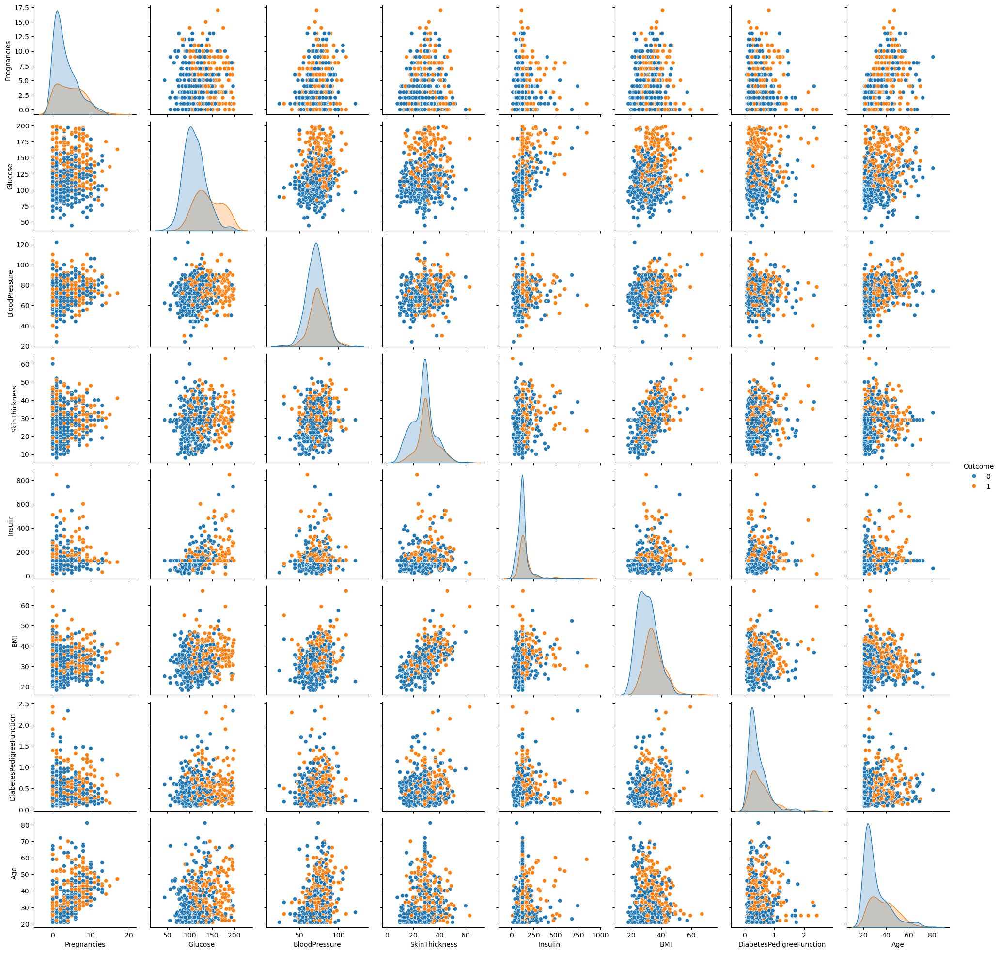

<Figure size 1200x800 with 0 Axes>

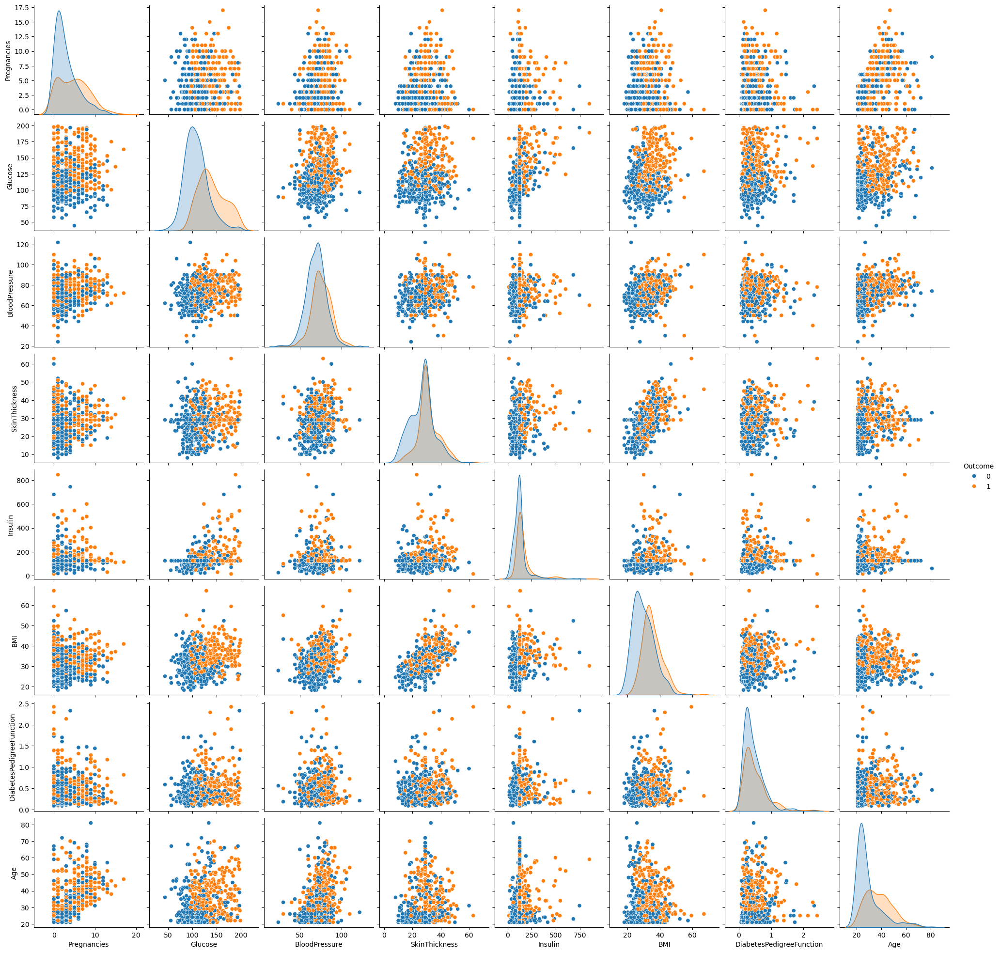

In [11]:
# Plot pair plot for the train data
df_train_true = pd.DataFrame(train_X)
df_train_true['Outcome'] = train_y
plt.figure(figsize=(12, 8))
sns.pairplot(df_train_true, hue='Outcome')
plt.show()

df_train_pre = pd.DataFrame(train_X)
df_train_pre['Outcome'] = grid_search.predict(train_X)
plt.figure(figsize=(12, 8))
sns.pairplot(df_train_pre, hue='Outcome')
plt.show()

Test data
              precision    recall  f1-score   support

           0      0.843     0.707     0.769        99
           1      0.592     0.764     0.667        55

    accuracy                          0.727       154
   macro avg      0.717     0.735     0.718       154
weighted avg      0.753     0.727     0.733       154



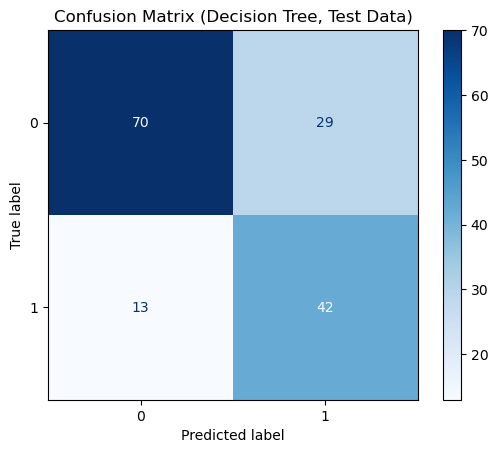

In [12]:
# Evaluate the model on test data
evaluate_model(grid_search, test_X, test_y, "Test", "Decision Tree")

<Figure size 1200x800 with 0 Axes>

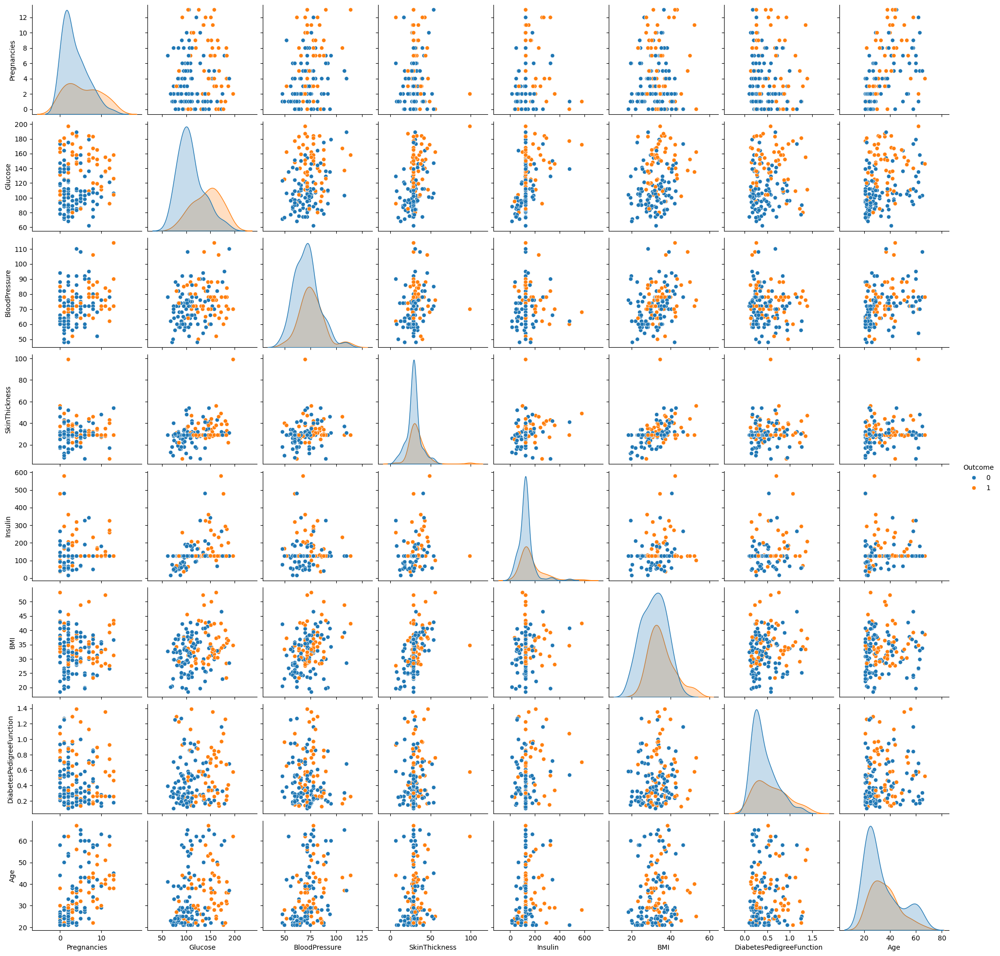

<Figure size 1200x800 with 0 Axes>

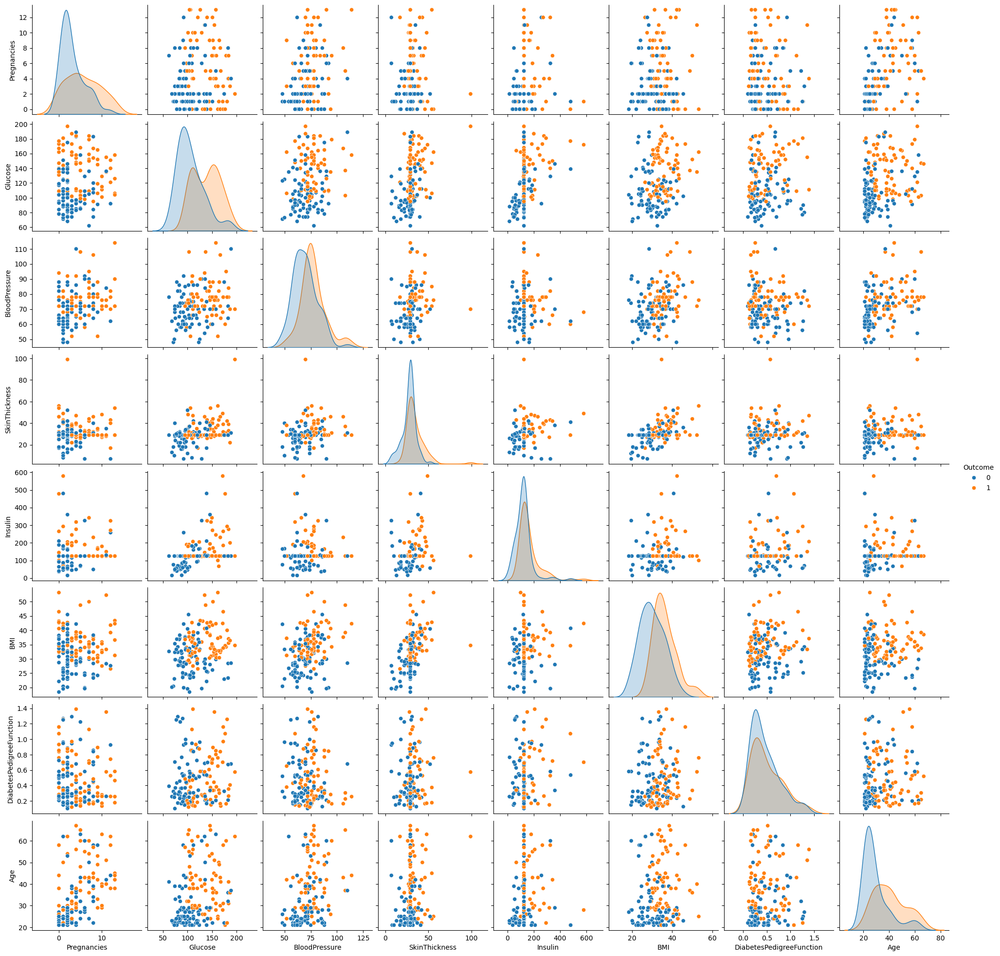

In [13]:
# Plot pair plot for the test data
df_test_true = pd.DataFrame(test_X)
df_test_true['Outcome'] = test_y
plt.figure(figsize=(12, 8))
sns.pairplot(df_test_true, hue='Outcome')
plt.show()

df_test_pre = pd.DataFrame(test_X)
df_test_pre['Outcome'] = grid_search.predict(test_X)
plt.figure(figsize=(12, 8))
sns.pairplot(df_test_pre, hue='Outcome')
plt.show()

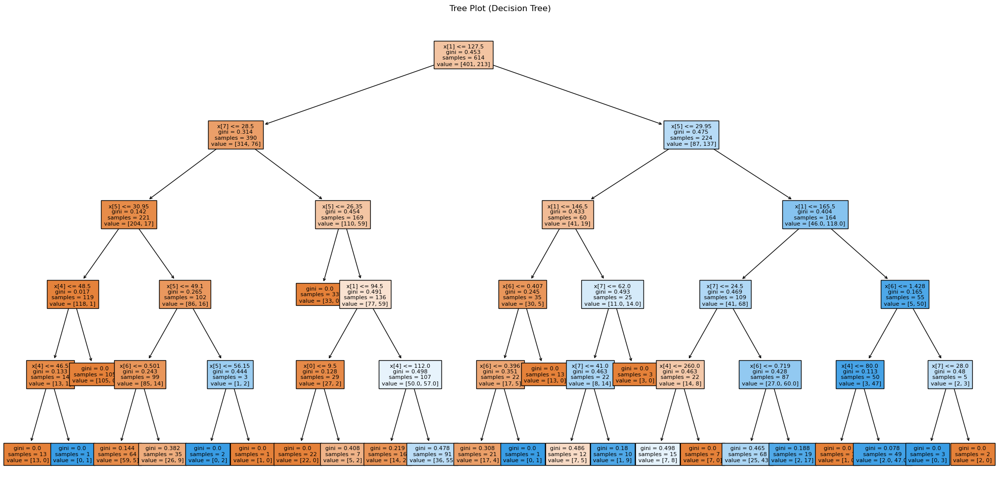

In [14]:
# Plot the decision tree
plt.figure(figsize=(20, 10))
tree.plot_tree(grid_search.best_estimator_, filled=True, fontsize=8)
plt.title("Tree Plot (Decision Tree)")
plt.tight_layout()
plt.show()

### K Nearest Neighbors

-----------------K Nearest Neighbors-----------------

Best Parameters: {'n_neighbors': 7}
Best Cross-Validation Score (Accuracy): 0.7606821787414068


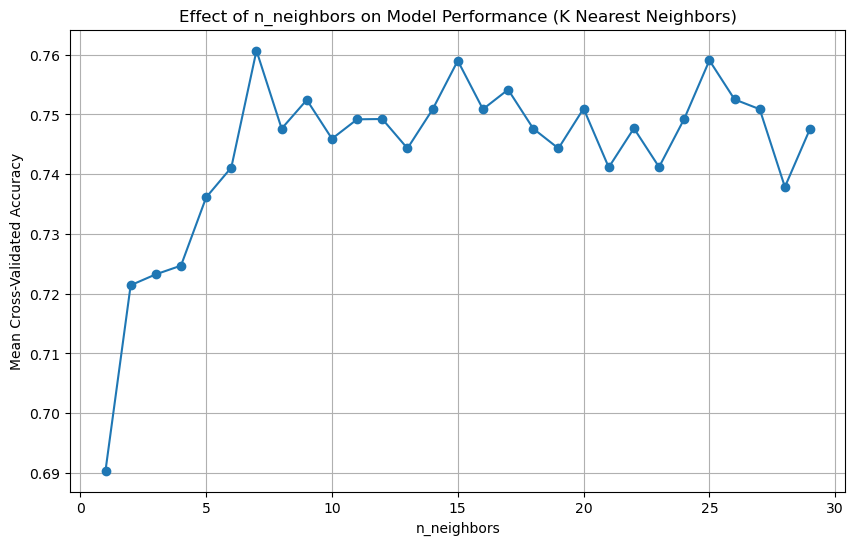

In [15]:
# Define the parameter grid
param_grid = {'n_neighbors': range(1, 30)}

# Initialize the K Nearest Neighbors Classifier
clf = KNeighborsClassifier()

# Initialize GridSearchCV with cross-validation
grid_search = GridSearchCV(estimator=clf, param_grid=param_grid, cv=kf, scoring='accuracy')

# Fit GridSearchCV to the training data
grid_search.fit(train_X, train_y)

# Plot n_neighbors vs. accuracy
plot_parameter_effect(grid_search, "n_neighbors", "K Nearest Neighbors",
                      "n_neighbors", "Mean Cross-Validated Accuracy")

Training data
              precision    recall  f1-score   support

           0      0.832     0.863     0.847       401
           1      0.722     0.671     0.696       213

    accuracy                          0.796       614
   macro avg      0.777     0.767     0.771       614
weighted avg      0.794     0.796     0.795       614



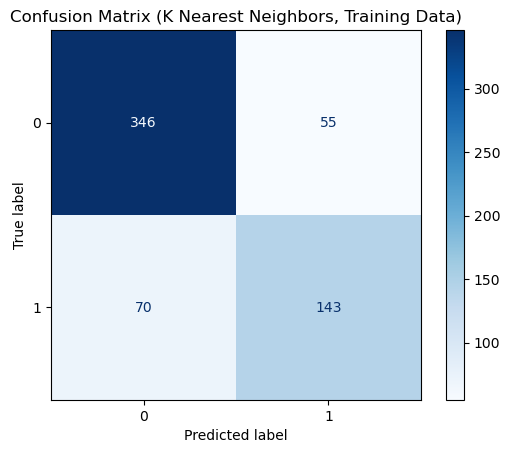

In [16]:
# Evaluate the model on training data
evaluate_model(grid_search, train_X, train_y, "Training", "K Nearest Neighbors")

<Figure size 1200x800 with 0 Axes>

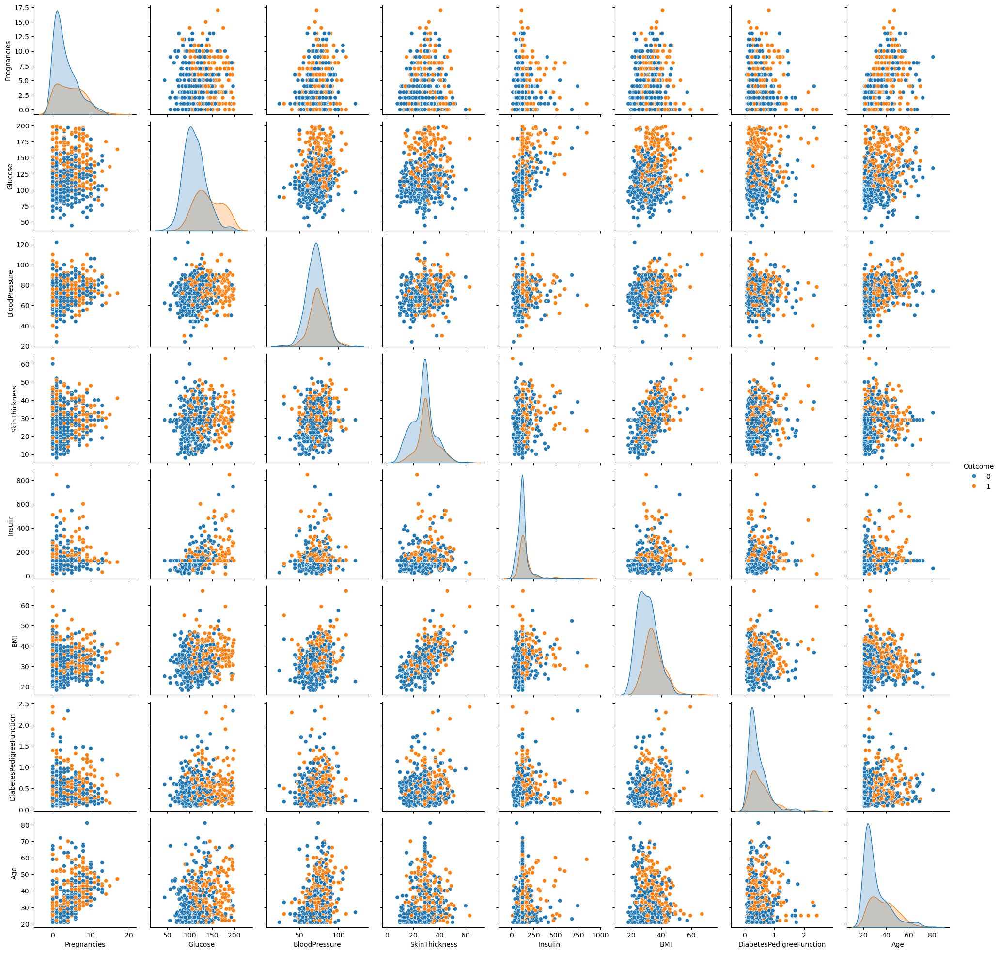

<Figure size 1200x800 with 0 Axes>

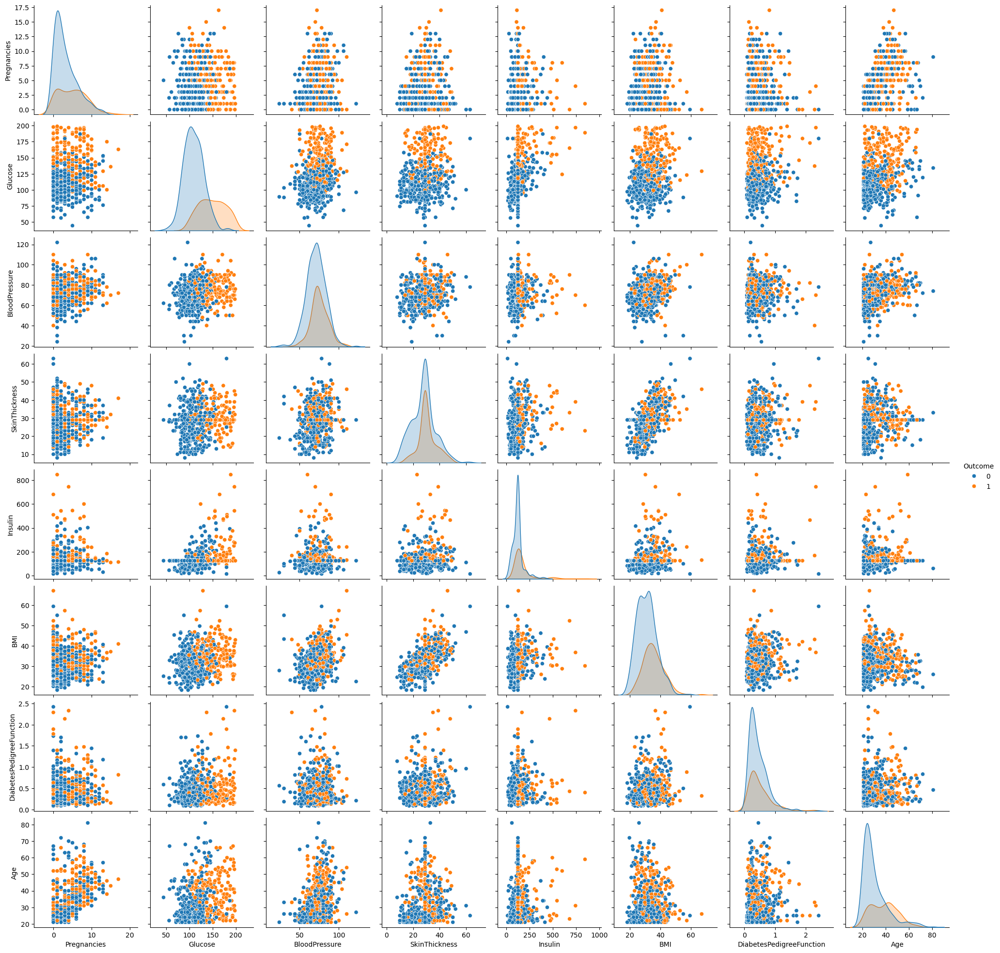

In [17]:
# Plot pair plot for the train data
plt.figure(figsize=(12, 8))
sns.pairplot(df_train_true, hue='Outcome')
plt.show()

df_train_pre = pd.DataFrame(train_X)
df_train_pre['Outcome'] = grid_search.predict(train_X)
plt.figure(figsize=(12, 8))
sns.pairplot(df_train_pre, hue='Outcome')
plt.show()

Test data
              precision    recall  f1-score   support

           0      0.775     0.697     0.734        99
           1      0.538     0.636     0.583        55

    accuracy                          0.675       154
   macro avg      0.657     0.667     0.659       154
weighted avg      0.691     0.675     0.680       154



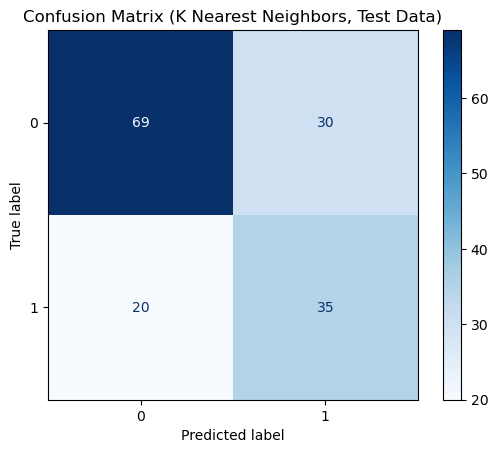

In [18]:
# Evaluate the model on test data
evaluate_model(grid_search, test_X, test_y, "Test", "K Nearest Neighbors")

<Figure size 1200x800 with 0 Axes>

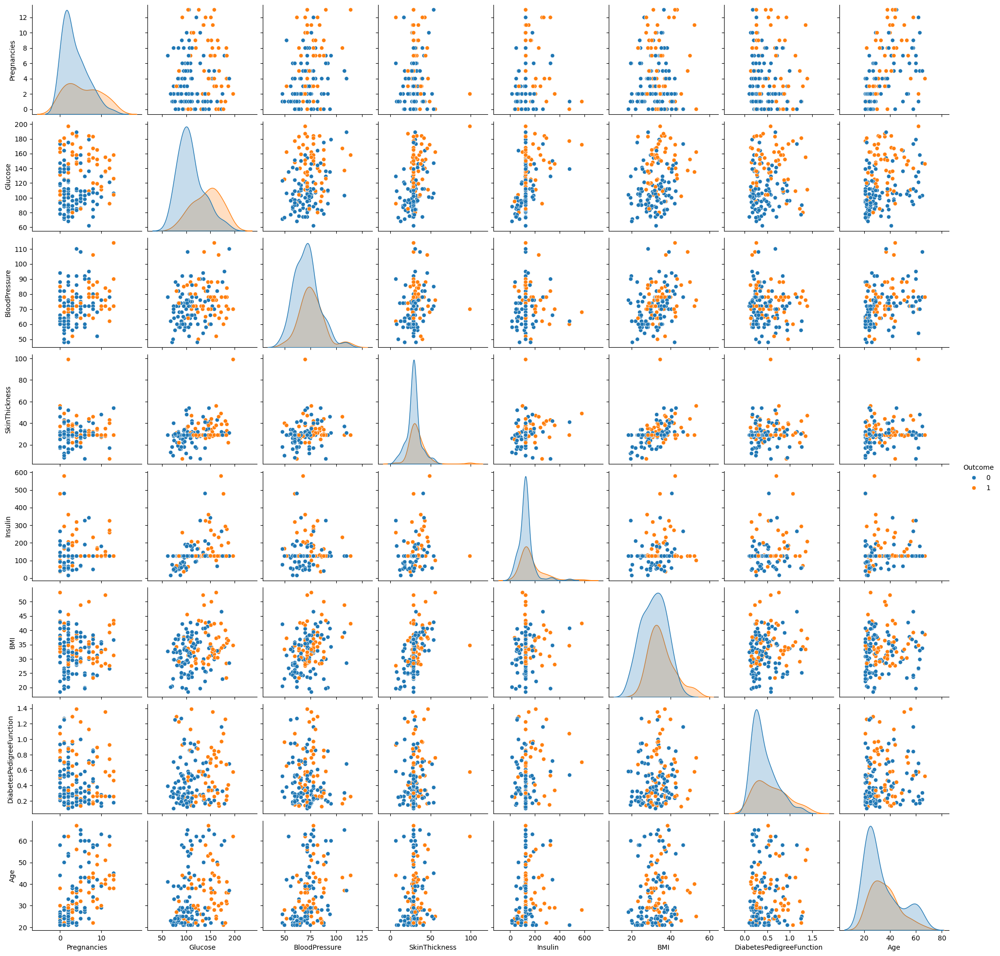

<Figure size 1200x800 with 0 Axes>

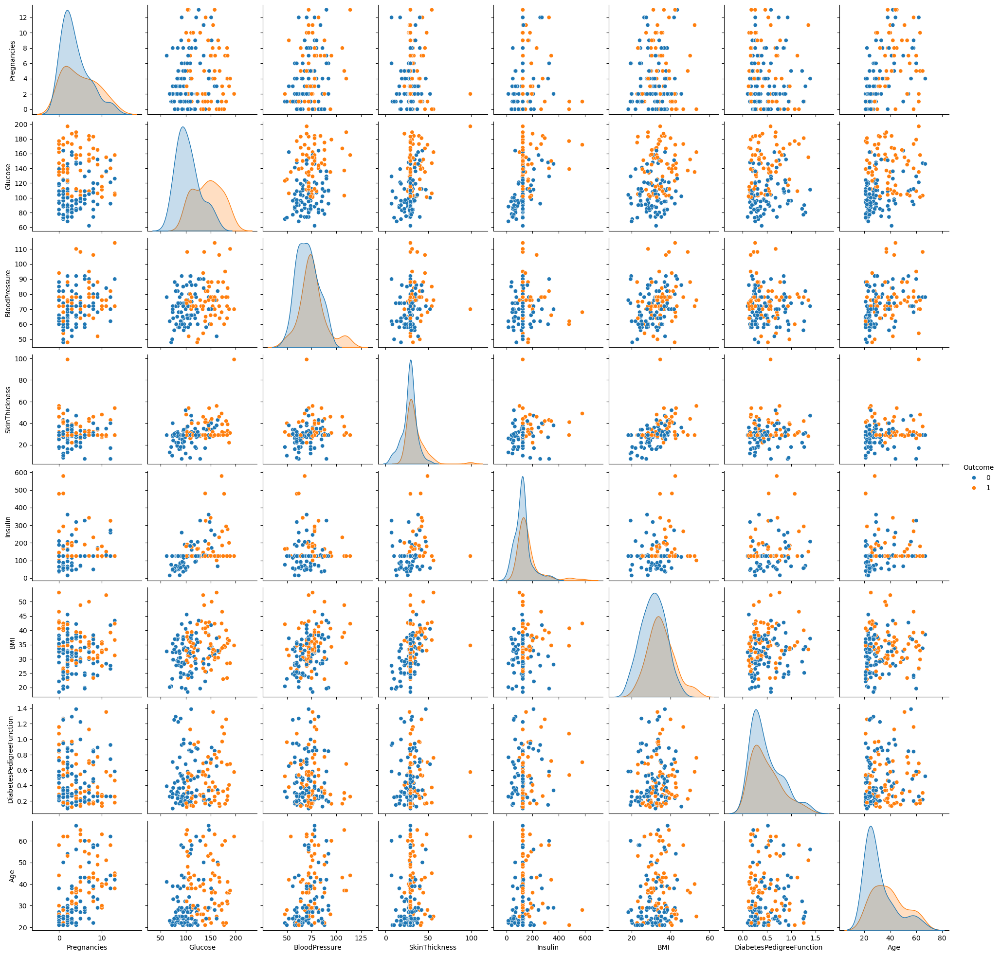

In [19]:
# Plot pair plot for the test data
plt.figure(figsize=(12, 8))
sns.pairplot(df_test_true, hue='Outcome')
plt.show()

df_test_pre = pd.DataFrame(test_X)
df_test_pre['Outcome'] = grid_search.predict(test_X)
plt.figure(figsize=(12, 8))
sns.pairplot(df_test_pre, hue='Outcome')
plt.show()

### Support Vector Machine

-----------------Support Vector Machine-----------------

Best Parameters: {'C': 100, 'gamma': 0.0001}
Best Cross-Validation Score (Accuracy): 0.7704653622421999


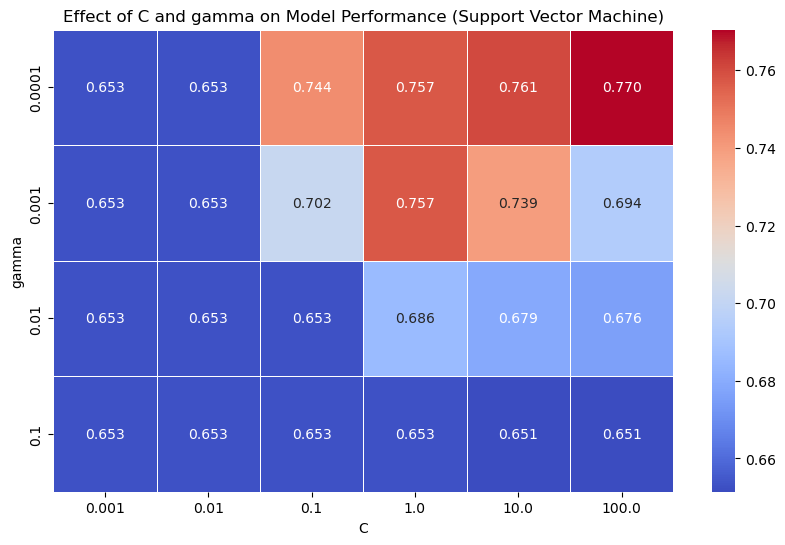

In [20]:
# Define the parameter grid
param_grid = {'C': [0.001, 0.01, 0.1, 1, 10, 100],
              'gamma': [0.0001, 0.001, 0.01, 0.1]}

# Initialize the Support Vector Machine Classifier
clf = svm.SVC()

# Initialize GridSearchCV with cross-validation
grid_search = GridSearchCV(estimator=clf, param_grid=param_grid, cv=kf, scoring='accuracy')

# Fit GridSearchCV to the training data
grid_search.fit(train_X, train_y)

# Define the function to plot parameter effect heatmap
def plot_parameter_effect_heatmap(grid_search, param1, param2, model):
    print(f'\nBest Parameters: {grid_search.best_params_}')
    print(f'Best Cross-Validation Score (Accuracy): {grid_search.best_score_}')
    
    # Extract mean test scores for each combination of parameters
    mean_test_scores = grid_search.cv_results_['mean_test_score']
    param1_values = grid_search.cv_results_[f'param_{param1}'].data
    param2_values = grid_search.cv_results_[f'param_{param2}'].data

    # Create a DataFrame for the heatmap
    scores_df = pd.DataFrame({
        param1: param1_values,
        param2: param2_values,
        'Mean Test Score': mean_test_scores
    })

    # Pivot the DataFrame to get a matrix suitable for heatmap
    scores_matrix = scores_df.pivot(index=param2, columns=param1, values='Mean Test Score')

    # Plot the heatmap
    plt.figure(figsize=(10, 6))
    sns.heatmap(scores_matrix, annot=True, fmt=".3f", cmap='coolwarm', linewidths=.5)
    plt.title("Effect of " + param1 + " and " + param2 + " on Model Performance (" + model + ")")
    plt.xlabel(param1)
    plt.ylabel(param2)
    plt.show()
    
# Plot C vs. gamma vs. accuracy heatmap
plot_parameter_effect_heatmap(grid_search, "C", "gamma", "Support Vector Machine")

Training data
              precision    recall  f1-score   support

           0      0.847     0.898     0.872       401
           1      0.783     0.695     0.736       213

    accuracy                          0.827       614
   macro avg      0.815     0.796     0.804       614
weighted avg      0.825     0.827     0.825       614



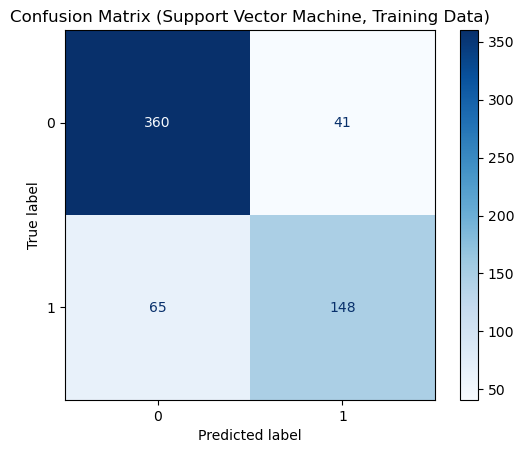

In [21]:
# Evaluate the model on training data
evaluate_model(grid_search, train_X, train_y, "Training", "Support Vector Machine")

<Figure size 1200x800 with 0 Axes>

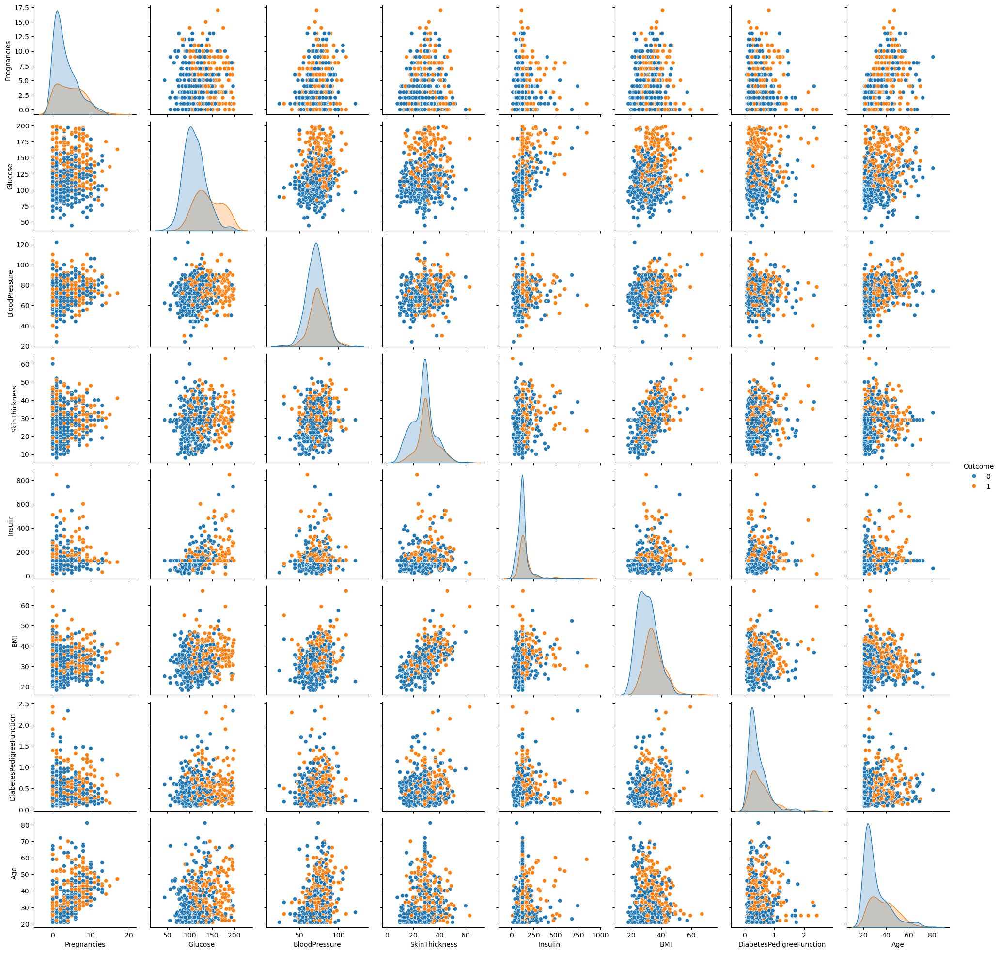

<Figure size 1200x800 with 0 Axes>

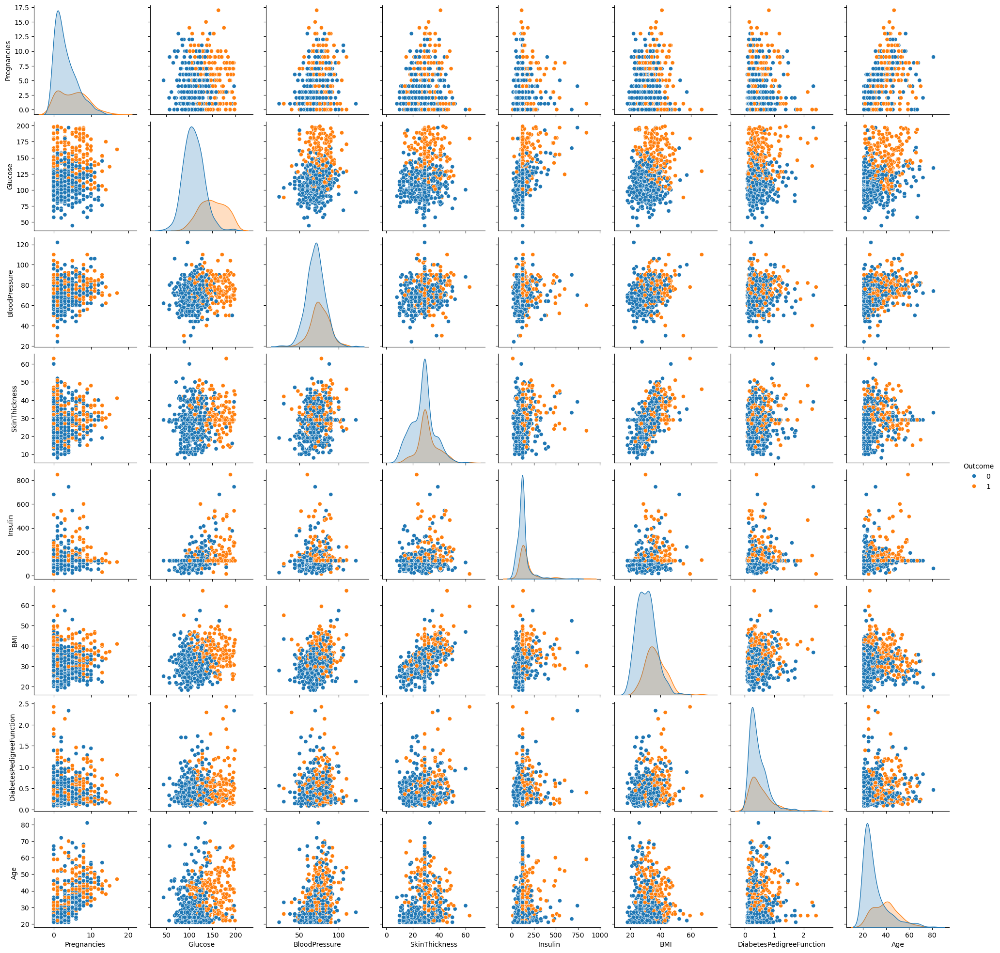

In [22]:
# Plot pair plot for the train data
plt.figure(figsize=(12, 8))
sns.pairplot(df_train_true, hue='Outcome')
plt.show()

df_train_pre = pd.DataFrame(train_X)
df_train_pre['Outcome'] = grid_search.predict(train_X)
plt.figure(figsize=(12, 8))
sns.pairplot(df_train_pre, hue='Outcome')
plt.show()

Test data
              precision    recall  f1-score   support

           0      0.776     0.768     0.772        99
           1      0.589     0.600     0.595        55

    accuracy                          0.708       154
   macro avg      0.682     0.684     0.683       154
weighted avg      0.709     0.708     0.708       154



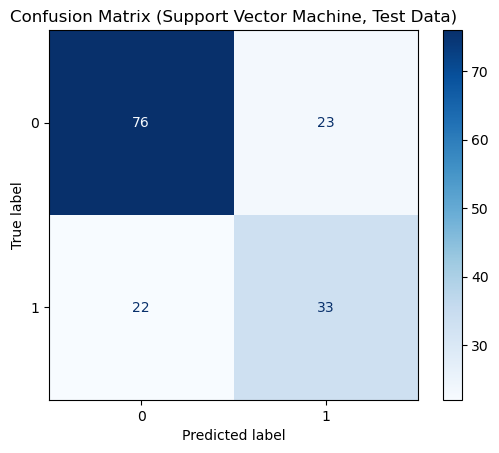

In [23]:
# Evaluate the model on test data
evaluate_model(grid_search, test_X, test_y, "Test", "Support Vector Machine")

<Figure size 1200x800 with 0 Axes>

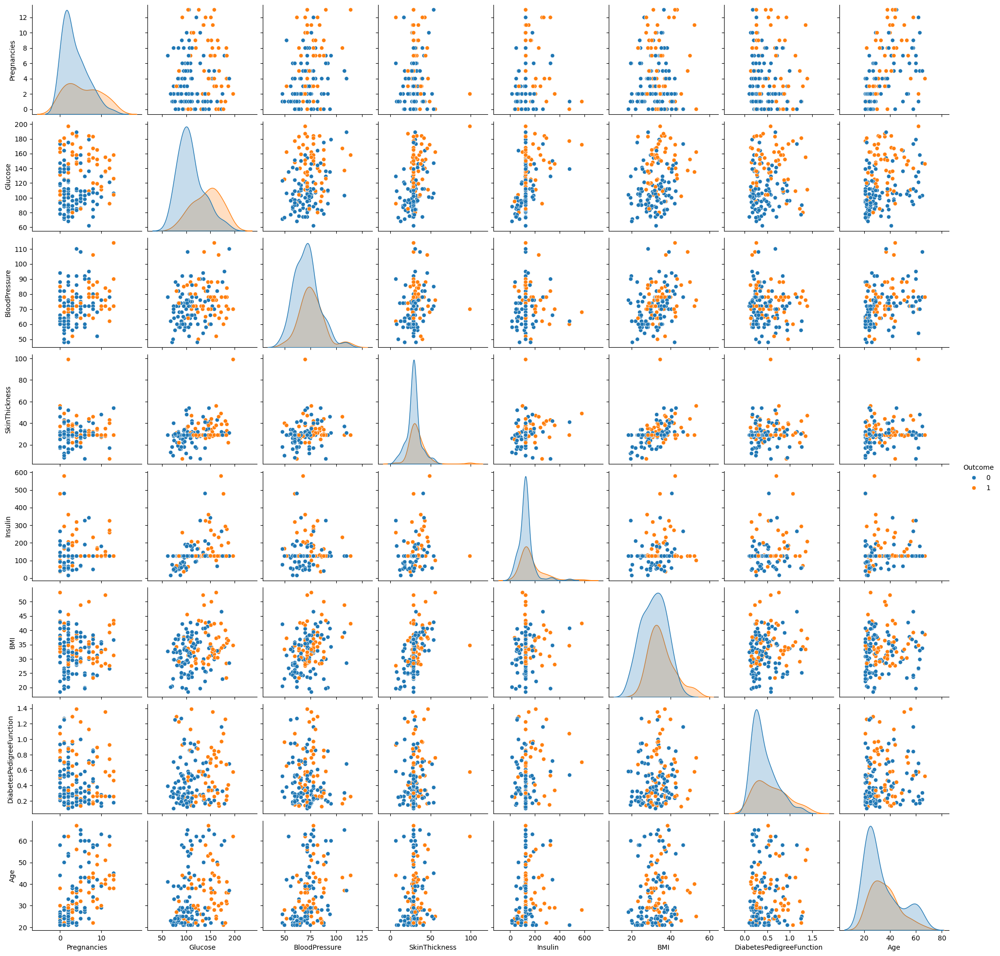

<Figure size 1200x800 with 0 Axes>

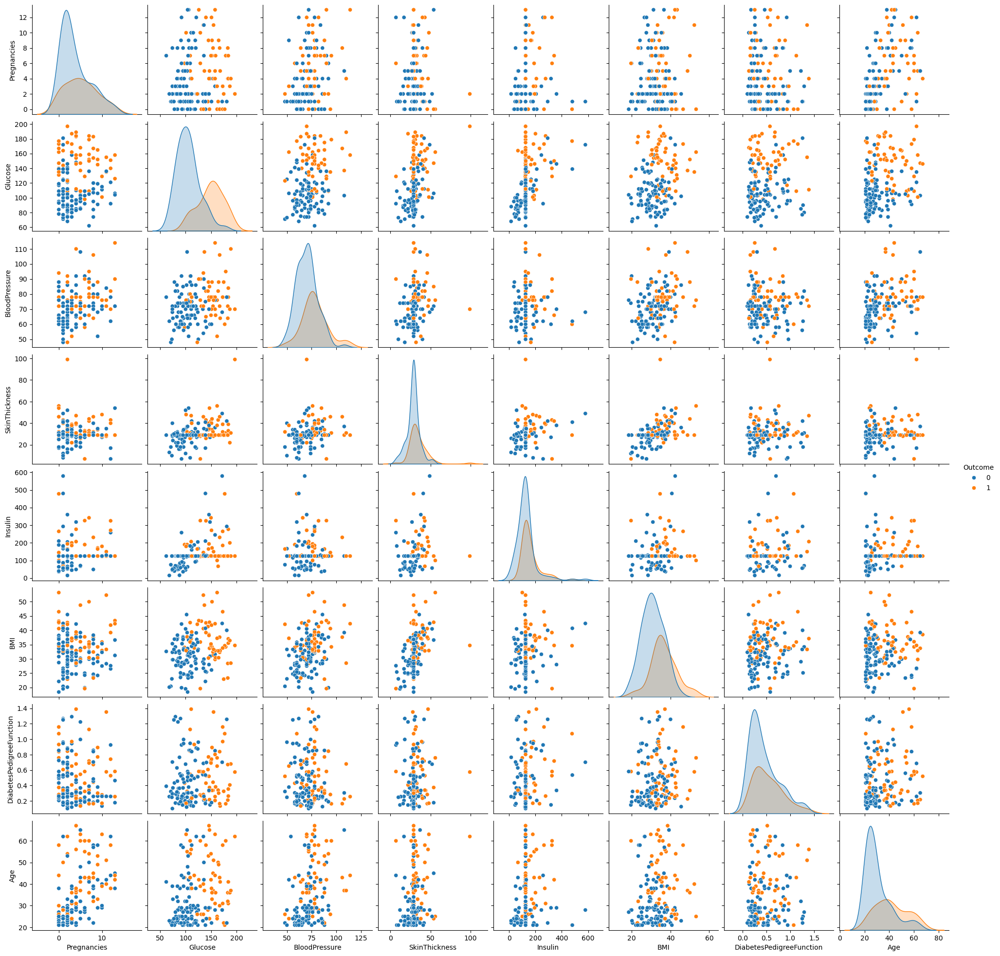

In [24]:
# Plot pair plot for the test data
plt.figure(figsize=(12, 8))
sns.pairplot(df_test_true, hue='Outcome')
plt.show()

df_test_pre = pd.DataFrame(test_X)
df_test_pre['Outcome'] = grid_search.predict(test_X)
plt.figure(figsize=(12, 8))
sns.pairplot(df_test_pre, hue='Outcome')
plt.show()

### Conclusion

- Applied three machine learning models: Decision Tree, K-Nearest Neighbors, and Support Vector Machine on a real-world classification task.
- Utilized GridSearchCV with k-fold cross-validation to find optimal hyperparameters.
- Achieved approximately 80% accuracy on training data and 70% on test data, with minimal differences between models.
- Results varied slightly based on train-test splits, highlighting the need for different splits to ensure reliability.
- Current accuracy is adequate for preliminary analysis but insufficient for practical diagnosis.
- Future improvements: Enhance data collection and increase dataset size.